<a href="https://colab.research.google.com/github/mitsuhazuki/deep-image-prior/blob/master/PROJET_denoising.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Partie 1


In [1]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/mitsuhazuki/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 356, done.
remote: Counting objects: 100% (67/67), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 356 (delta 23), reused 7 (delta 0), pack-reused 289
Receiving objects: 100% (356/356), 132.52 MiB | 16.16 MiB/s, done.
Resolving deltas: 100% (178/178), done.


## Import libs

In [2]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *

import torch
import torch.optim

from skimage.metrics import peak_signal_noise_ratio
from utils.denoising_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

In [3]:
## denoising
# image must be 24 bit color
fname = 'data/denoising/F16_GT.png'

## Load image

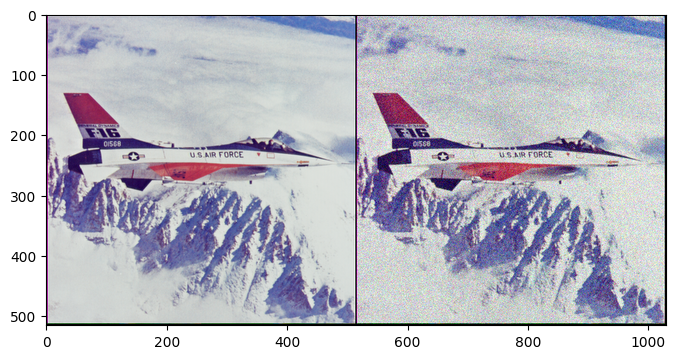

In [4]:
# Add synthetic noise
img_pil = crop_image(get_image(fname, imsize)[0], d=32)
img_np = pil_to_np(img_pil)

img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)

if PLOT:
    plot_image_grid([img_np, img_noisy_np], 4, 6)

## Setup

In [5]:
INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 100
exp_weight=0.99


num_iter = 3000
input_depth = 32
figsize = 4


net = get_net(input_depth, 'skip', pad,
              skip_n33d=128,
              skip_n33u=128,
              skip_n11=4,
              num_scales=5,
              upsample_mode='bilinear').type(dtype)

    
net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()

# Compute number of parameters
s  = sum([np.prod(list(p.size())) for p in net.parameters()])
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

Number of params: 2217831


## Optimize

Starting optimization with ADAM
Iteration 00000    Loss 0.084903   PSNR_noisy: 10.710757   PSRN_gt: 11.171959 PSNR_gt_sm: 11.171959

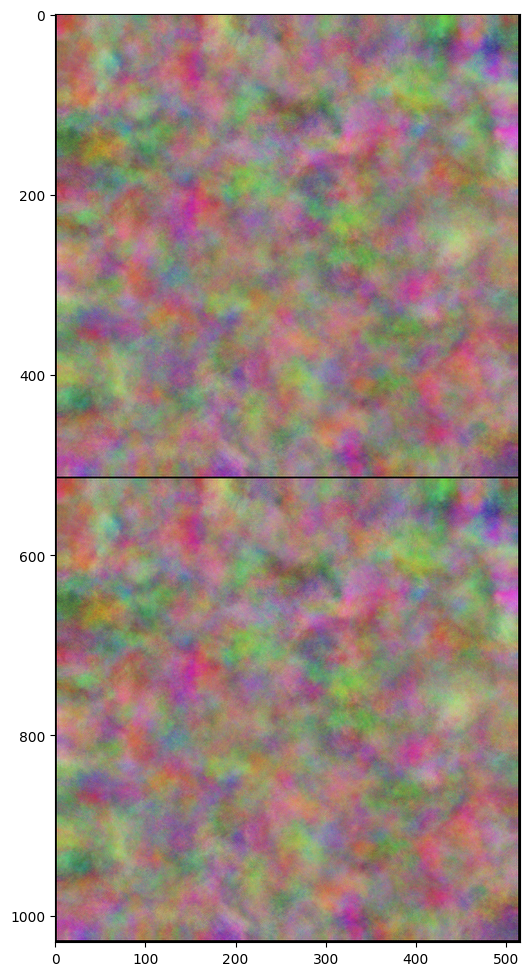

Iteration 00100    Loss 0.018085   PSNR_noisy: 17.426719   PSRN_gt: 20.454113 PSNR_gt_sm: 16.841737

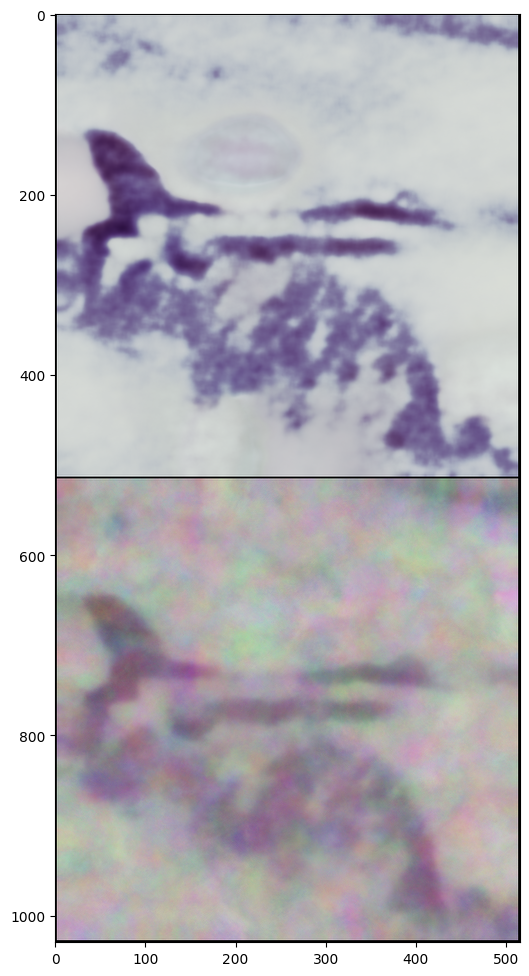

Iteration 00200    Loss 0.014670   PSNR_noisy: 18.335798   PSRN_gt: 22.537207 PSNR_gt_sm: 21.015081

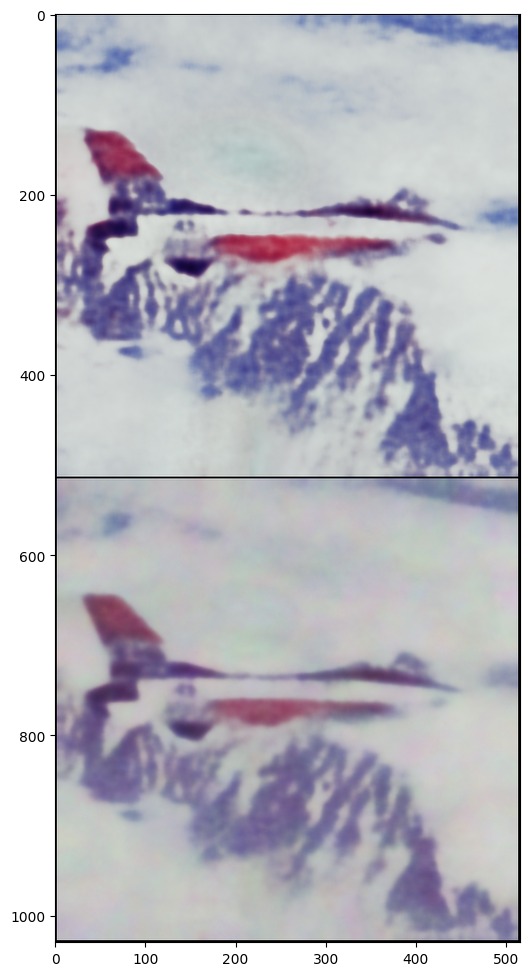

Iteration 00300    Loss 0.013403   PSNR_noisy: 18.728036   PSRN_gt: 23.663744 PSNR_gt_sm: 23.353529

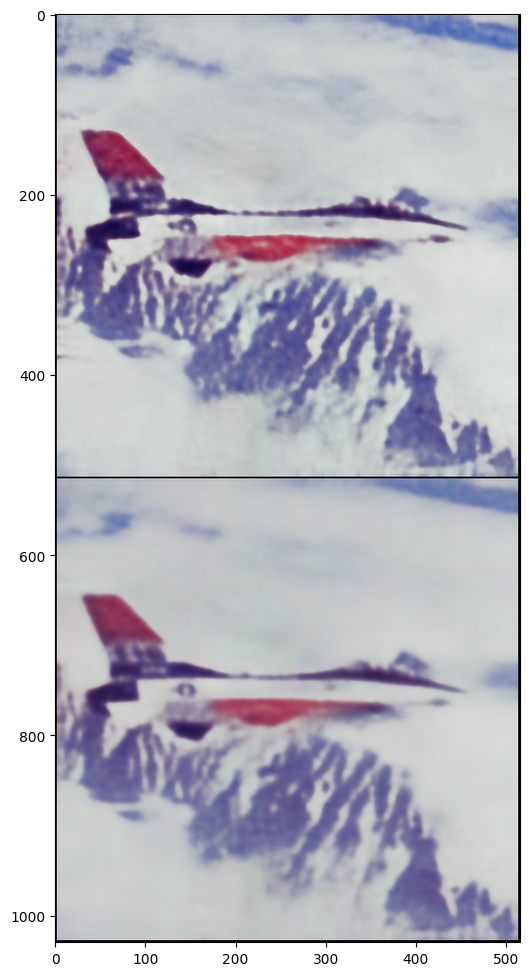

Iteration 00400    Loss 0.012788   PSNR_noisy: 18.932091   PSRN_gt: 24.293428 PSNR_gt_sm: 24.638618

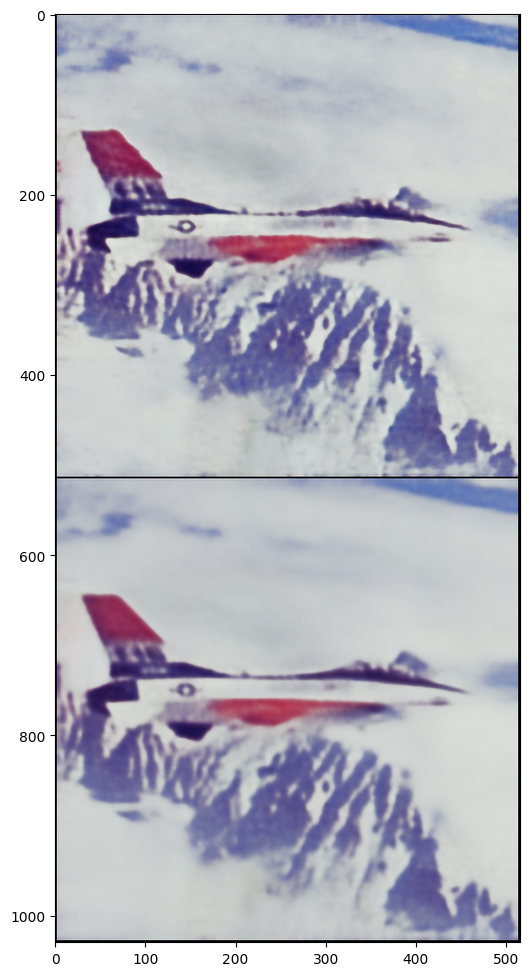

Iteration 00500    Loss 0.012184   PSNR_noisy: 19.142260   PSRN_gt: 25.037906 PSNR_gt_sm: 25.556224

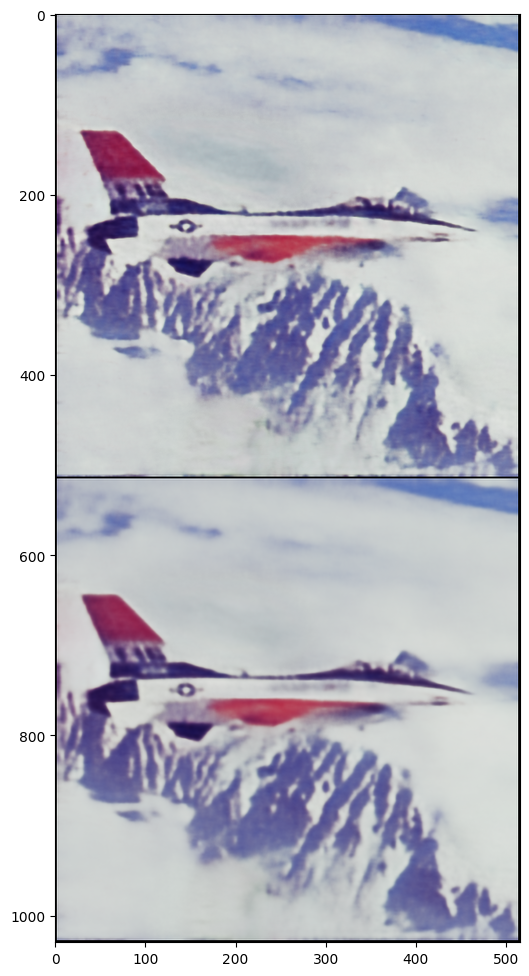

Iteration 00600    Loss 0.011651   PSNR_noisy: 19.336191   PSRN_gt: 25.816085 PSNR_gt_sm: 26.470230

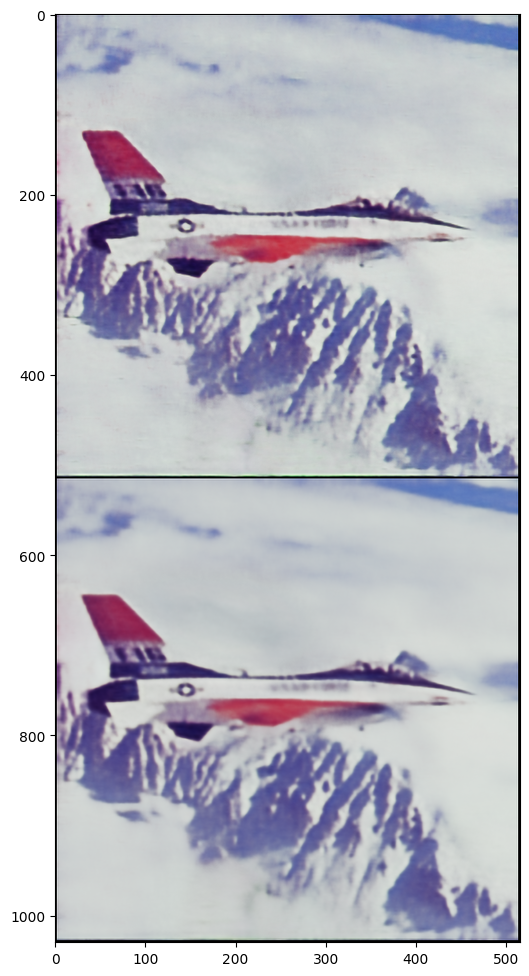

Iteration 00700    Loss 0.011242   PSNR_noisy: 19.491665   PSRN_gt: 26.501306 PSNR_gt_sm: 27.319771

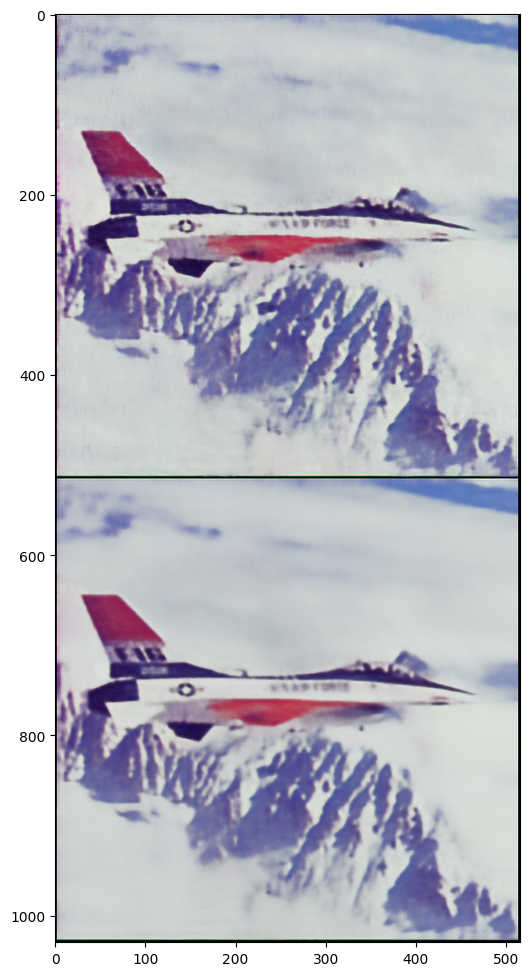

Iteration 00800    Loss 0.010867   PSNR_noisy: 19.639037   PSRN_gt: 27.342244 PSNR_gt_sm: 28.216444

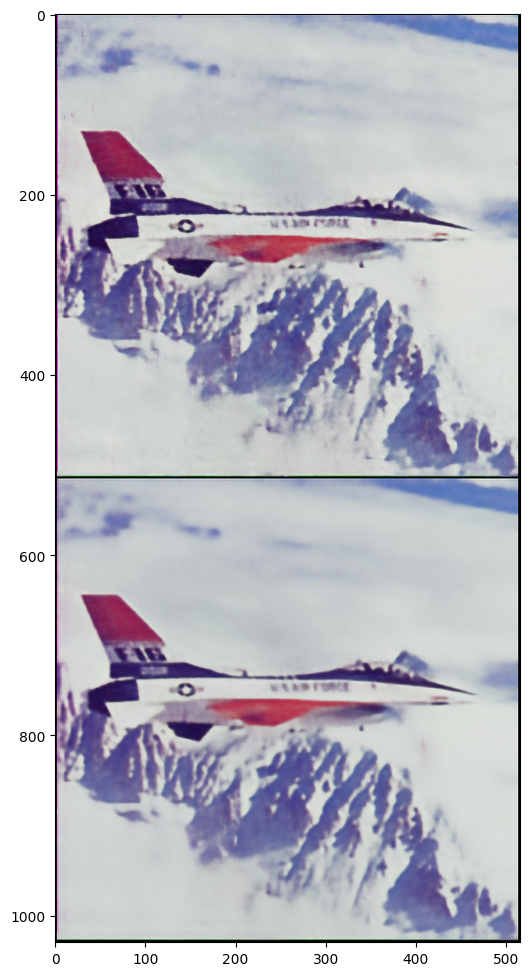

Iteration 00900    Loss 0.010656   PSNR_noisy: 19.723859   PSRN_gt: 27.824379 PSNR_gt_sm: 29.094245

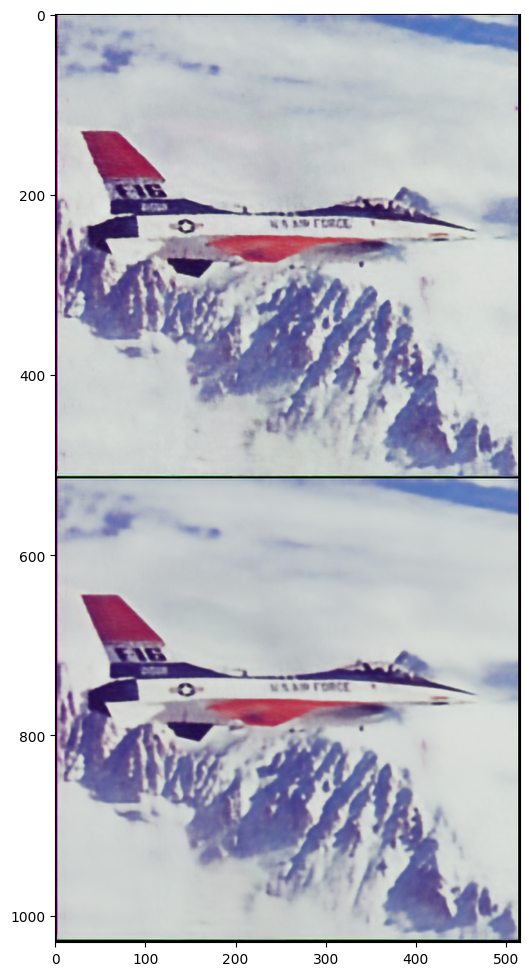

Iteration 01000    Loss 0.010493   PSNR_noisy: 19.790897   PSRN_gt: 28.198531 PSNR_gt_sm: 29.646104

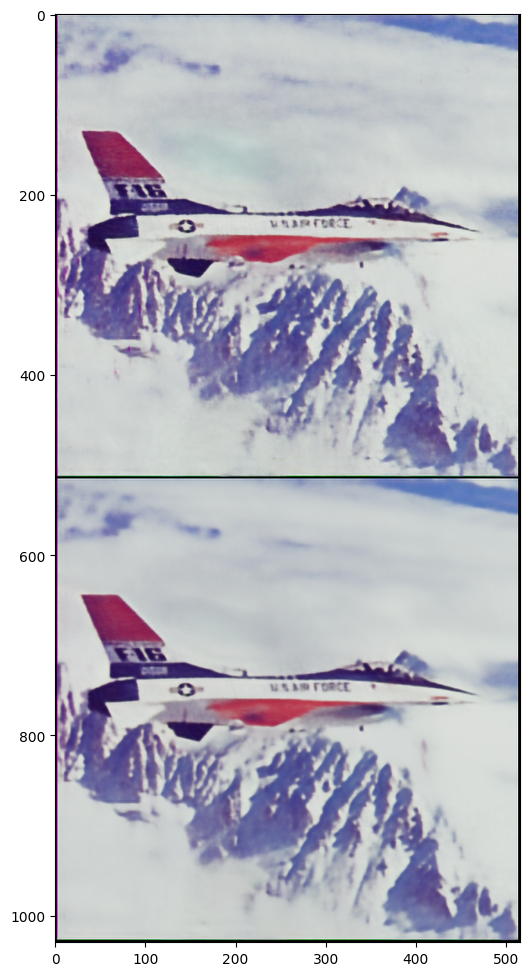

Iteration 01100    Loss 0.010351   PSNR_noisy: 19.850033   PSRN_gt: 28.631772 PSNR_gt_sm: 30.095585

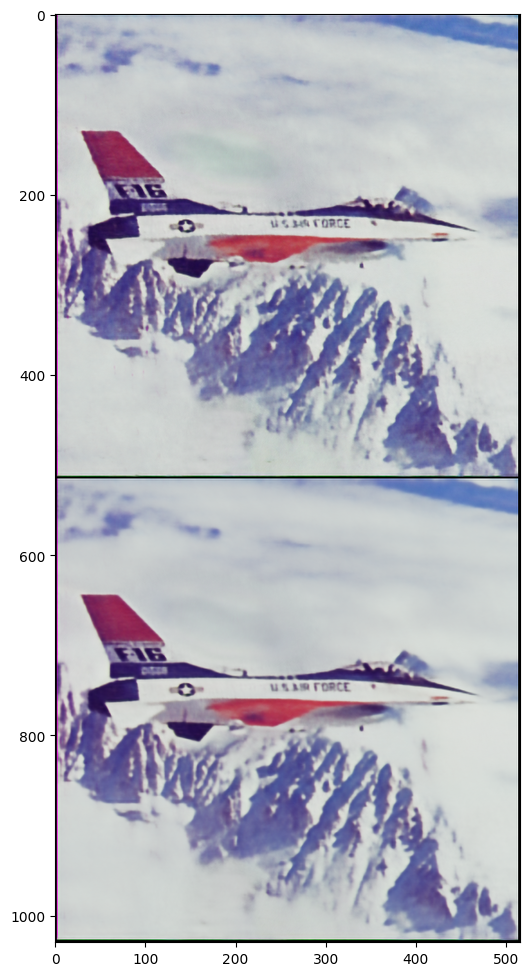

Iteration 01200    Loss 0.010240   PSNR_noisy: 19.897178   PSRN_gt: 28.915401 PSNR_gt_sm: 30.502833

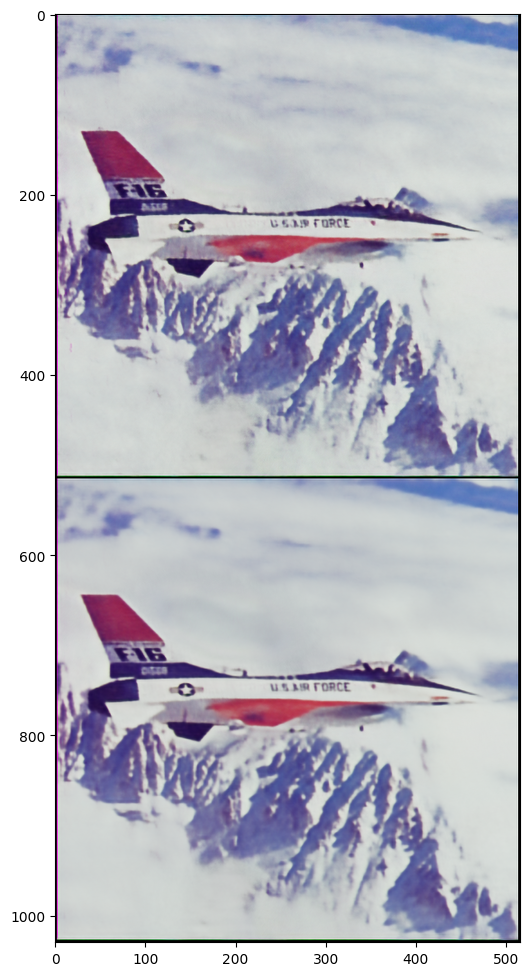

Iteration 01300    Loss 0.010158   PSNR_noisy: 19.932030   PSRN_gt: 29.067362 PSNR_gt_sm: 30.853858

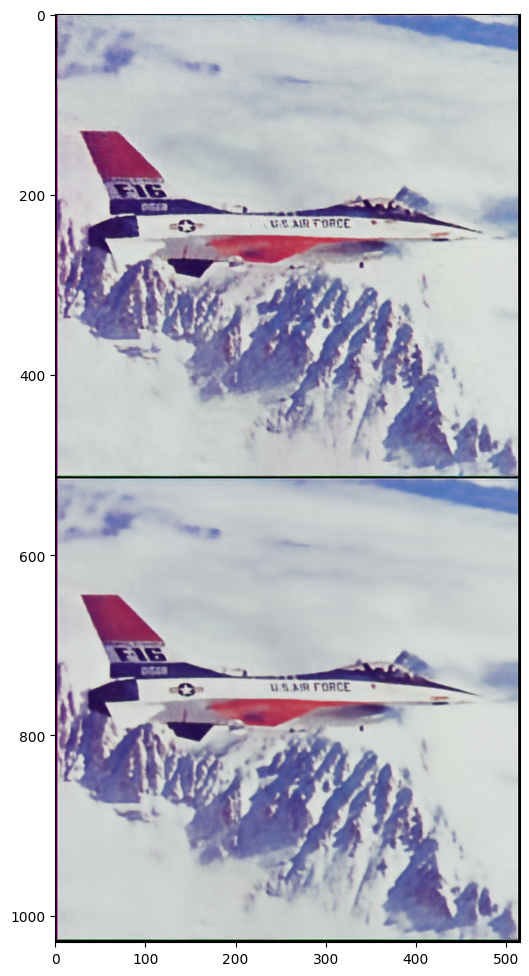

Iteration 01400    Loss 0.010009   PSNR_noisy: 19.995967   PSRN_gt: 29.511651 PSNR_gt_sm: 31.171483

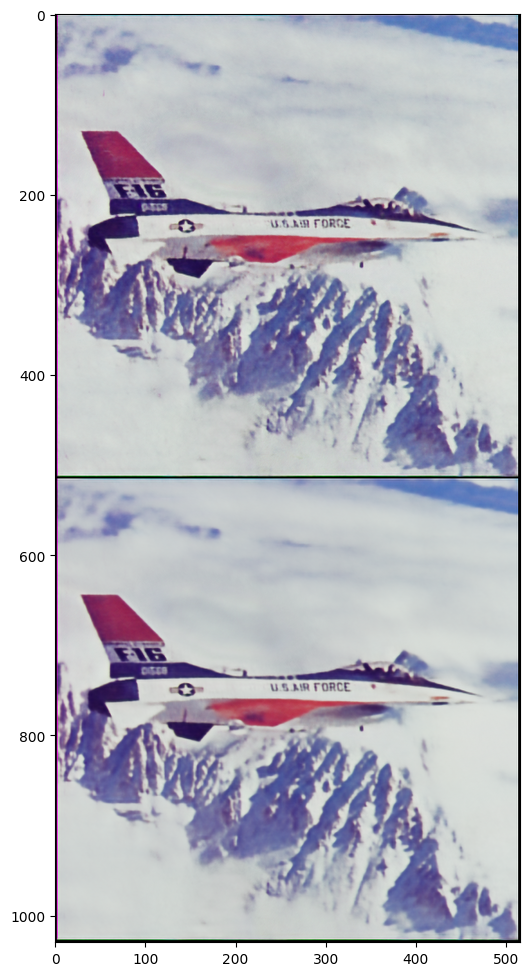

Iteration 01500    Loss 0.010014   PSNR_noisy: 19.993890   PSRN_gt: 29.468091 PSNR_gt_sm: 31.447896

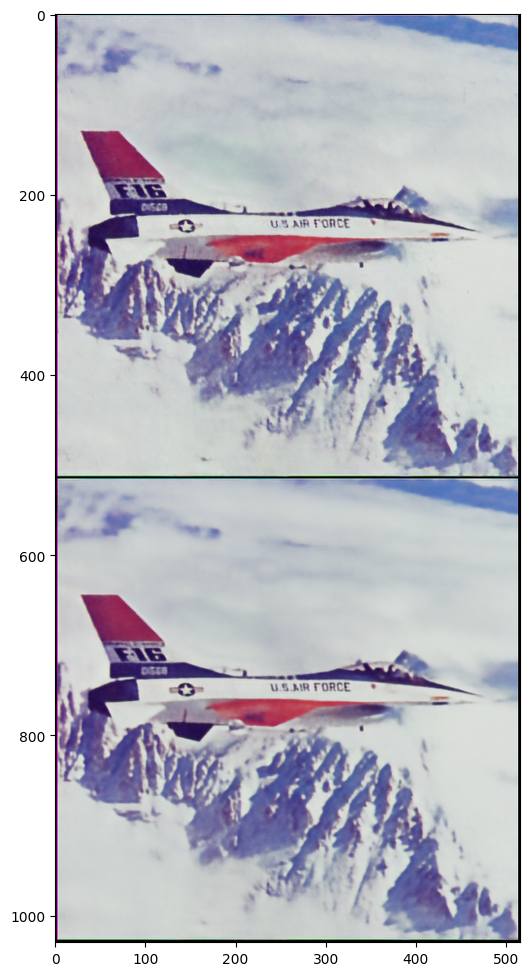

Iteration 01600    Loss 0.009919   PSNR_noisy: 20.035180   PSRN_gt: 29.726309 PSNR_gt_sm: 31.676627

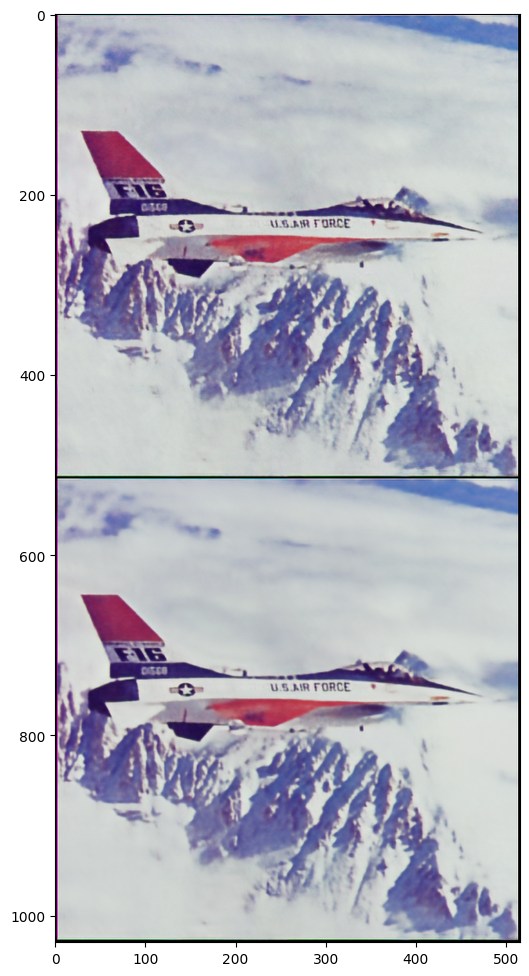

Iteration 01700    Loss 0.009830   PSNR_noisy: 20.074295   PSRN_gt: 30.022002 PSNR_gt_sm: 31.873693

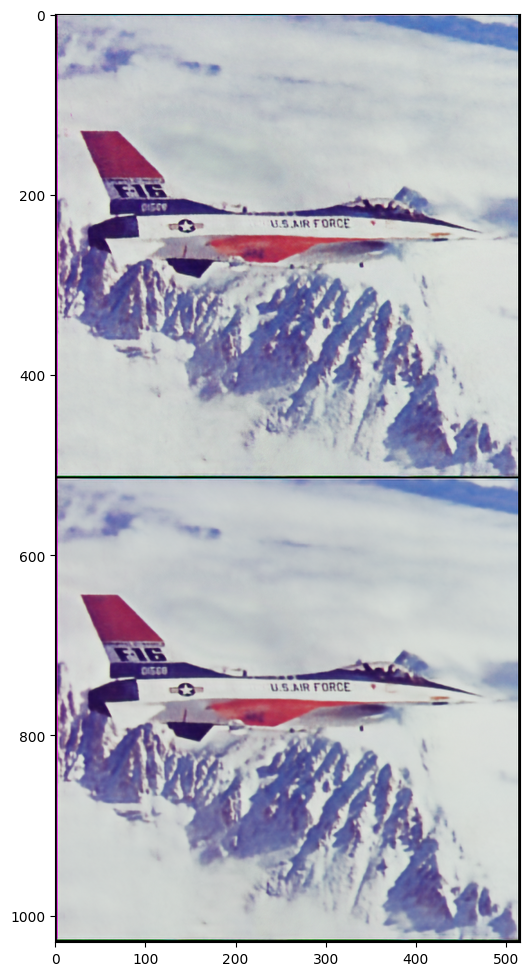

Iteration 01800    Loss 0.009815   PSNR_noisy: 20.081047   PSRN_gt: 29.969487 PSNR_gt_sm: 32.045924

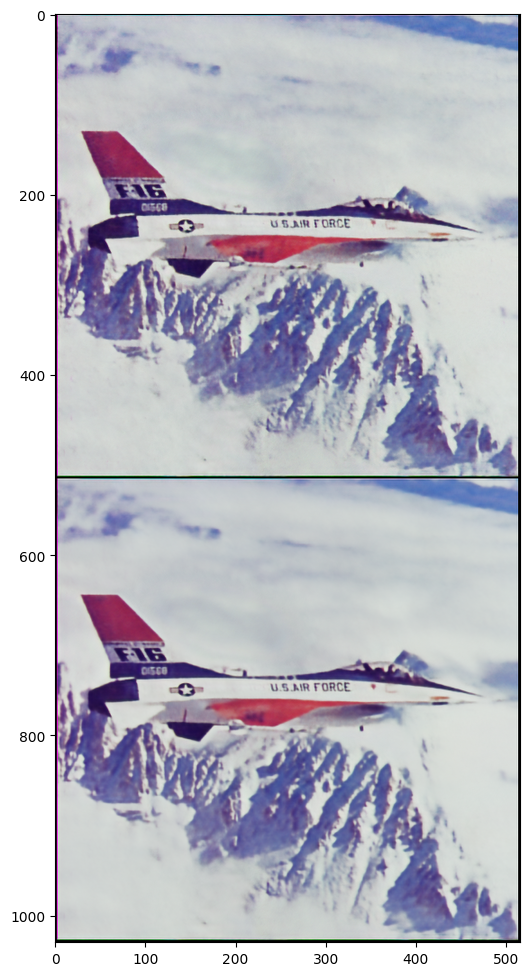

Iteration 01900    Loss 0.009742   PSNR_noisy: 20.113374   PSRN_gt: 30.163715 PSNR_gt_sm: 32.203067

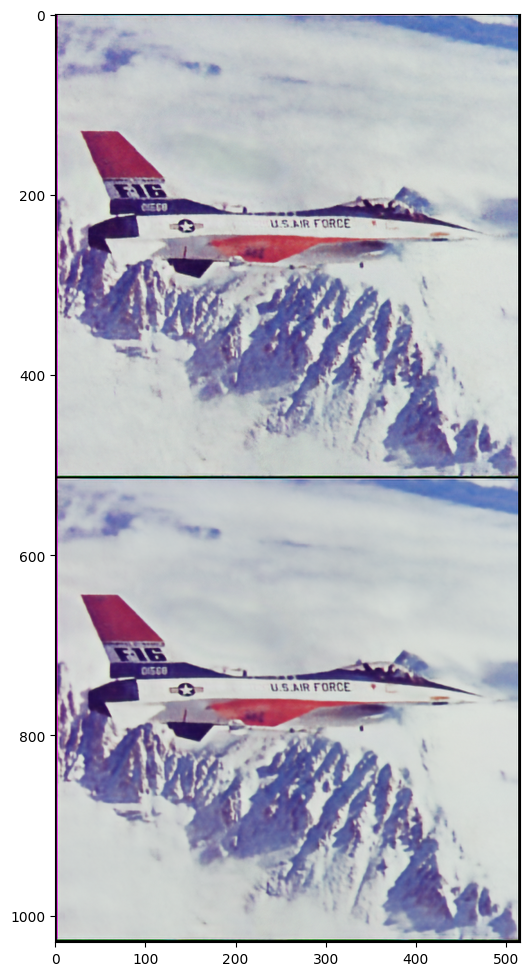

Iteration 02000    Loss 0.009686   PSNR_noisy: 20.138734   PSRN_gt: 30.280162 PSNR_gt_sm: 32.328951

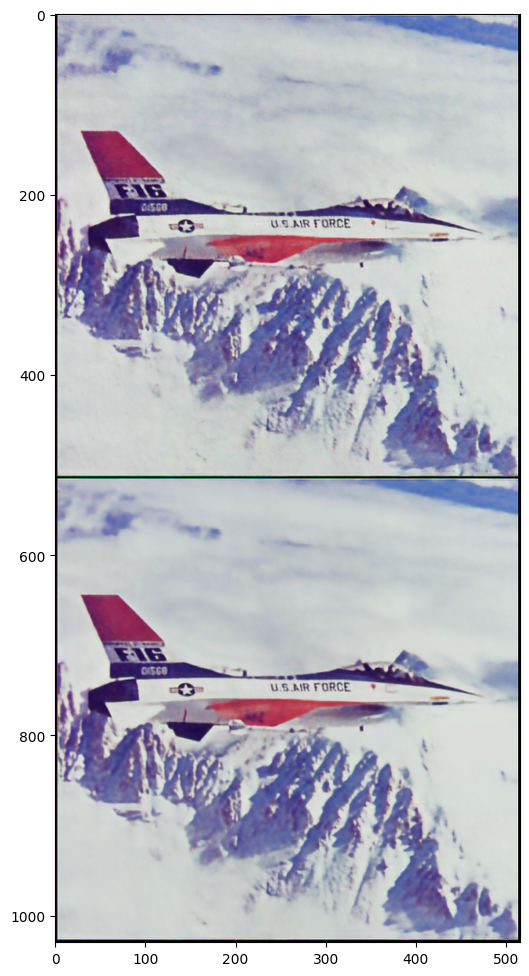

Iteration 02100    Loss 0.009624   PSNR_noisy: 20.166535   PSRN_gt: 30.421511 PSNR_gt_sm: 32.444697

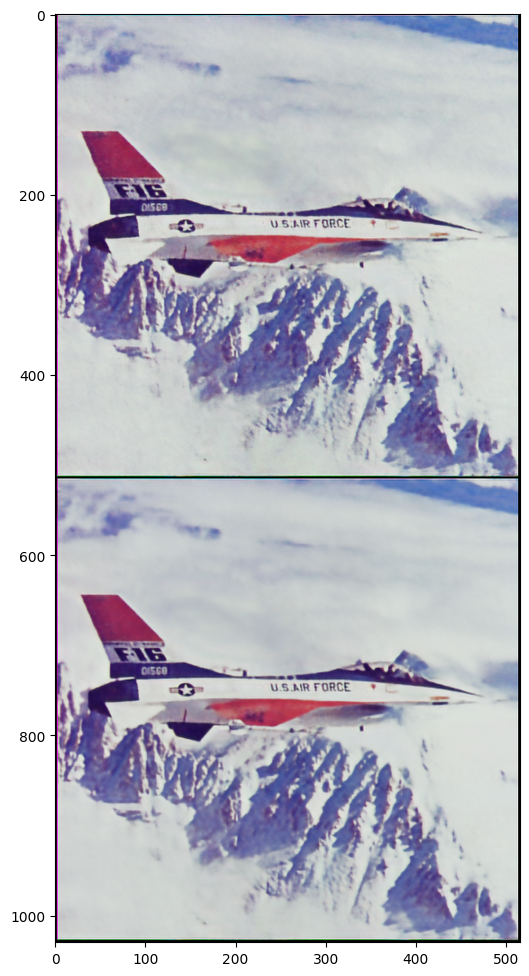

Iteration 02200    Loss 0.009658   PSNR_noisy: 20.151300   PSRN_gt: 30.156296 PSNR_gt_sm: 32.530086

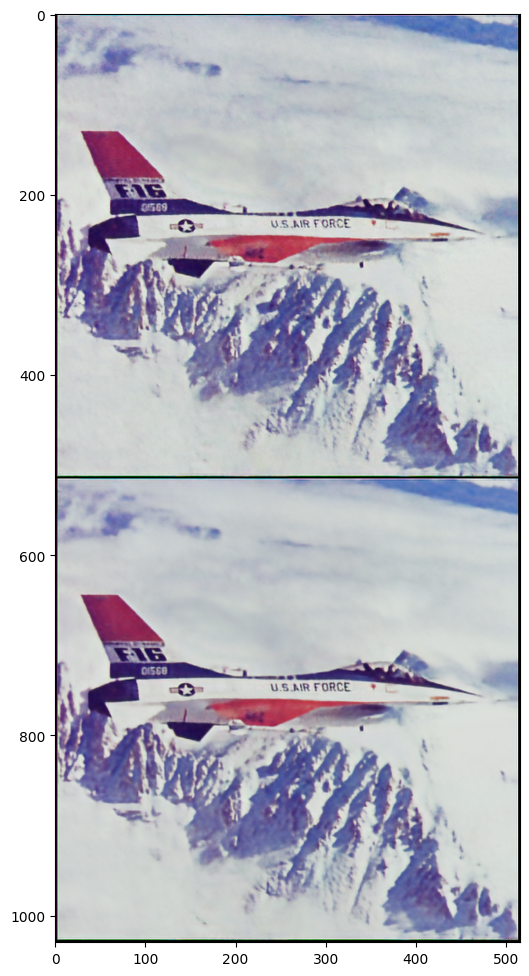

Iteration 02300    Loss 0.009528   PSNR_noisy: 20.210111   PSRN_gt: 30.577934 PSNR_gt_sm: 32.602997

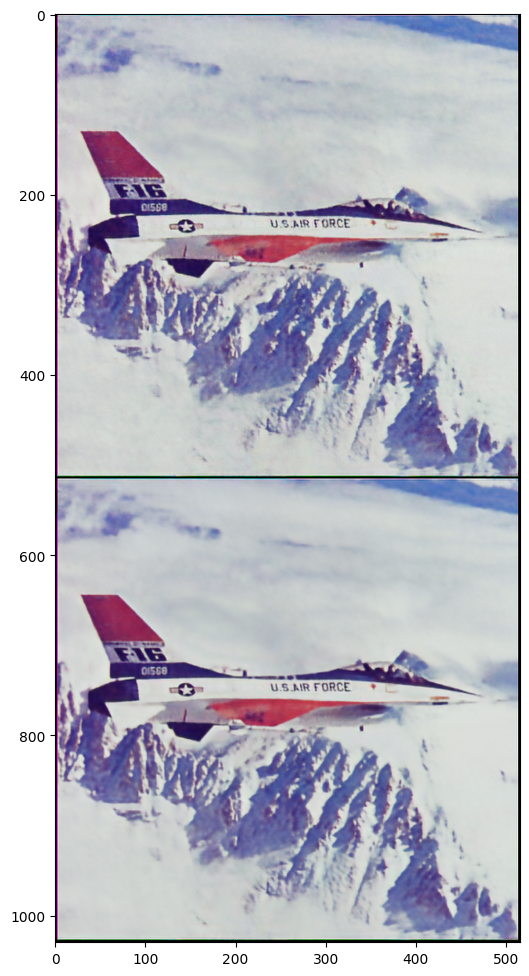

Iteration 02400    Loss 0.009539   PSNR_noisy: 20.205196   PSRN_gt: 30.345772 PSNR_gt_sm: 32.657972

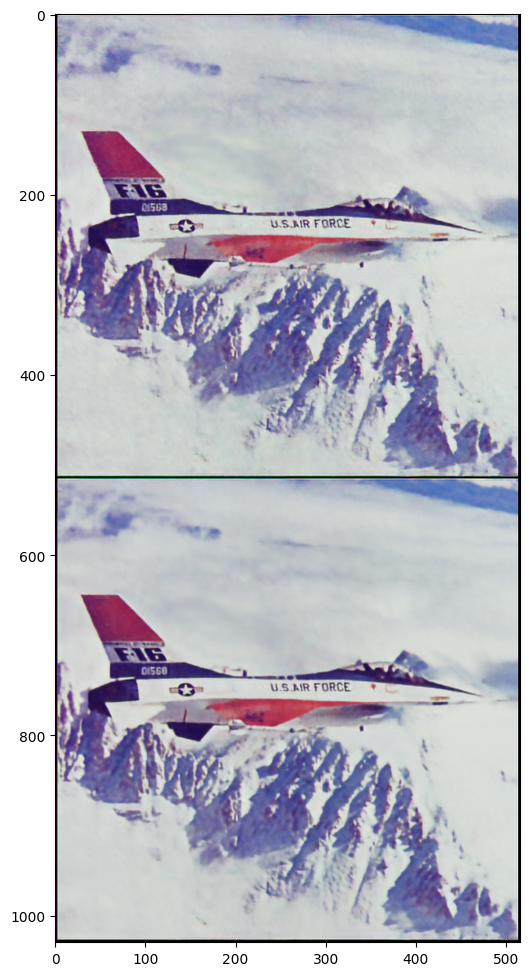

Iteration 02500    Loss 0.009440   PSNR_noisy: 20.250424   PSRN_gt: 30.715814 PSNR_gt_sm: 32.698288

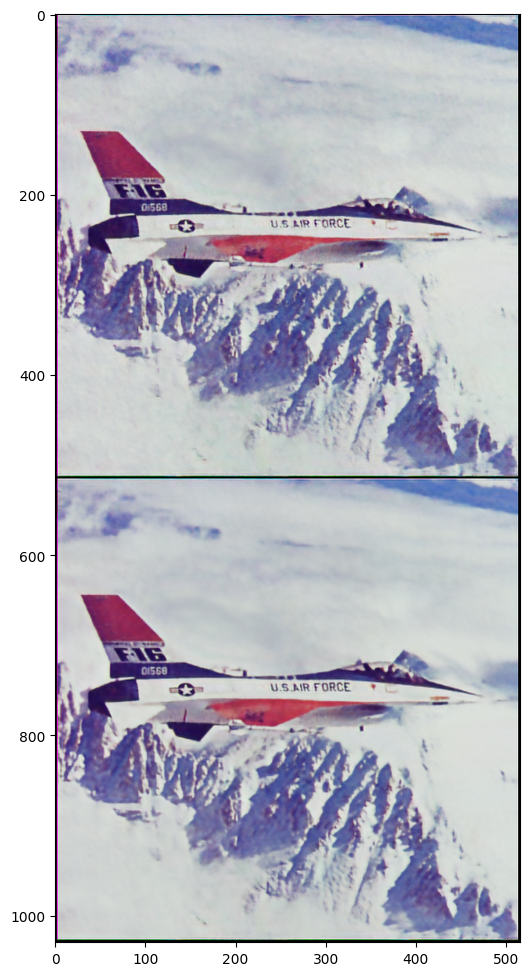

Iteration 02600    Loss 0.009443   PSNR_noisy: 20.248763   PSRN_gt: 30.467345 PSNR_gt_sm: 32.719482

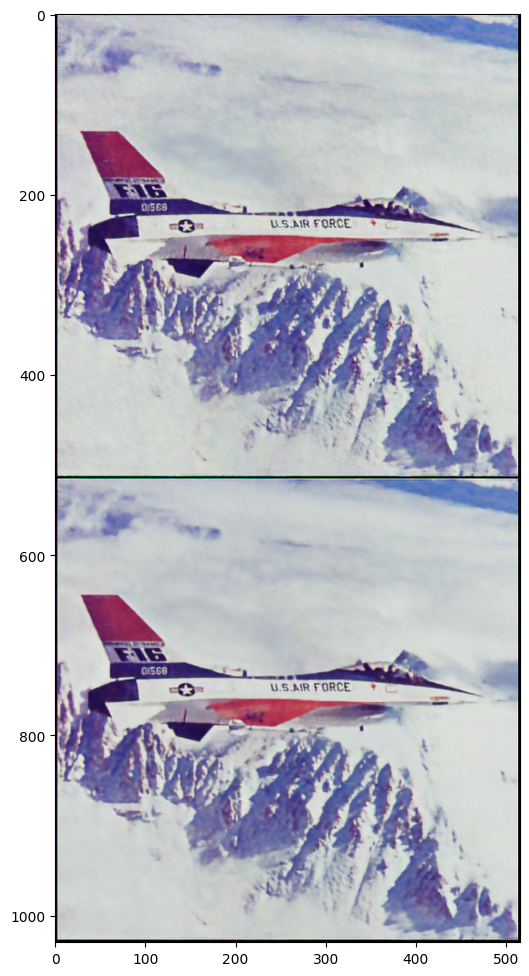

Iteration 02700    Loss 0.009364   PSNR_noisy: 20.285199   PSRN_gt: 30.624138 PSNR_gt_sm: 32.724111

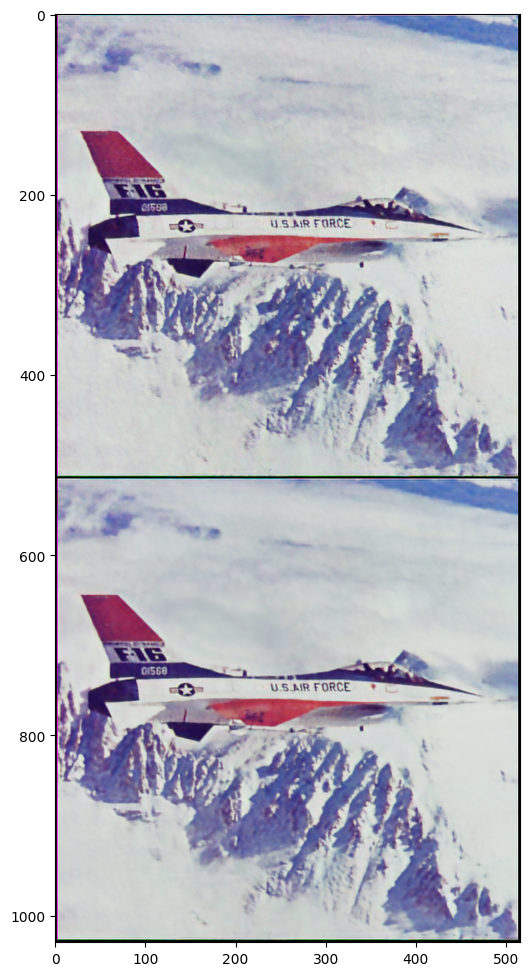

Iteration 02800    Loss 0.009327   PSNR_noisy: 20.302439   PSRN_gt: 30.523423 PSNR_gt_sm: 32.709091

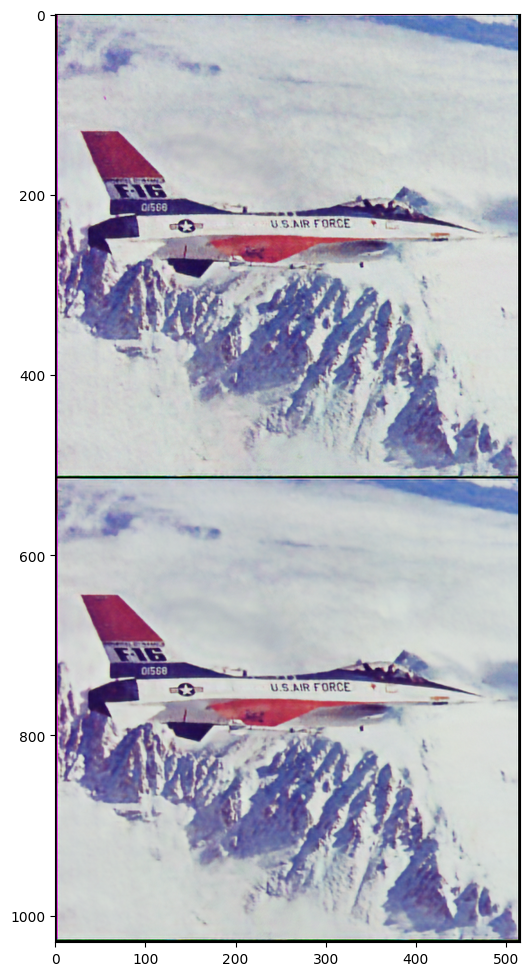

Iteration 02900    Loss 0.009270   PSNR_noisy: 20.329133   PSRN_gt: 30.545365 PSNR_gt_sm: 32.689345

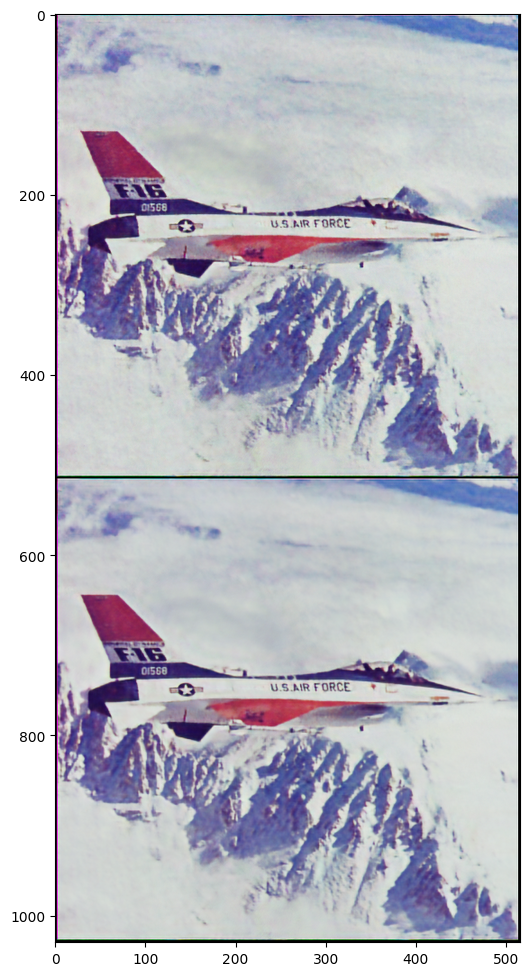

Iteration 02999    Loss 0.009292   PSNR_noisy: 20.318787   PSRN_gt: 30.141743 PSNR_gt_sm: 32.645009

In [6]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()
out_avg = None
last_net = None
psrn_noisy_last = 0

i = 0
def closure():
    
    global i, out_avg, psrn_noisy_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)
    
    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()
        
    
    psrn_noisy = peak_signal_noise_ratio(img_noisy_np, out.detach().cpu().numpy()[0])
    psrn_gt    = peak_signal_noise_ratio(img_np, out.detach().cpu().numpy()[0])
    psrn_gt_sm = peak_signal_noise_ratio(img_np, out_avg.detach().cpu().numpy()[0])
    
    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    print ('\rIteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1), 
                         np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
        
        
    
    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5: 
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy
            
    i += 1

    return total_loss

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

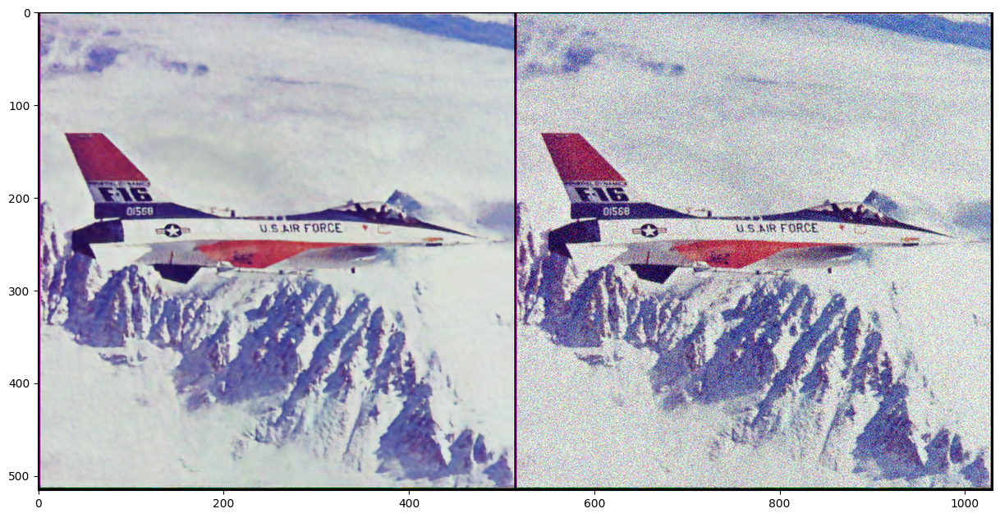

In [7]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), img_noisy_np], factor=13);

# Partie 2

## 1 - Variance

## New Section